### Importing Libraries 

Let's import some libraries for data preprocessing and visualisation.

In [2]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import seaborn as sns
import datetime
import calendar
from datetime import date       

#### Column Descriptors 
| Weathr part | Rides part |
|---|---|
| Temp: Temperature in F | Distance: The Distance Between Source and Destination |
| Location: Location Name | Cab_type: Uber or Lyft |
| Clouds: Clouds | Time_stamp: Epoch Time When Data was Queried |
| Pressure: Pressure in MB | Destination: Destination of the Ride |
| Rain: Rain in Inches for the Last Hr. | Source: The Starting Point of the Ride |
| Time_stamp: Epoch Time When Row Data was Collected | Price: Price Estimate for the Ride in USD |
| Humidity: Humidity in % | Surge_multiplier: The Multiplier by Which Price was Increased, Default 1 |
| Wind: Wind Speed in MPH | Id: Unique Identifier |
|  | Product_id: Uber/Lyft Identifier for Cab-type |
|  | Product_id: Uber/Lyft Identifier for Cab-type|

### Data Loading

In [3]:
# Set the maximum number of columns to display
pd.set_option("display.max_columns",None)
pd.set_option('display.width', None)
pd.options.display.max_seq_items = None

df = pd.read_csv(r"dataset/rideshare_kaggle.csv", encoding= 'unicode_escape')


In [3]:
# Take a look at the first 15 rows of the dataset
df.head(15)

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,lyft_line,Shared,5.0,0.44,1.0,42.2148,-71.0330,42.34,37.12,Mostly Cloudy,Rain throughout the day.,0.0000,0.0,0.68,8.66,9.17,1545015600,10.000,43.68,1544968800,34.19,1545048000,37.95,1544968800,27.39,1545044400,partly-cloudy-night,32.70,1021.98,57,0.72,0,10.000,303.8,1544962084,1544994864,0.30,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,lyft_premier,Lux,11.0,0.44,1.0,42.2148,-71.0330,43.58,37.35,Rain,"Rain until morning, starting again in the eve...",0.1299,1.0,0.94,11.98,11.98,1543291200,4.786,47.30,1543251600,42.10,1543298400,43.92,1543251600,36.20,1543291200,rain,41.83,1003.97,90,1.00,0,4.786,291.1,1543232969,1543266992,0.64,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,lyft,Lyft,7.0,0.44,1.0,42.2148,-71.0330,38.33,32.93,Clear,Light rain in the morning.,0.0000,0.0,0.75,7.33,7.33,1543334400,10.000,47.55,1543320000,33.10,1543402800,44.12,1543320000,29.11,1543392000,clear-night,31.10,992.28,240,0.03,0,10.000,315.7,1543319437,1543353364,0.68,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,lyft_luxsuv,Lux Black XL,26.0,0.44,1.0,42.2148,-71.0330,34.38,29.63,Clear,Partly cloudy throughout the day.,0.0000,0.0,0.73,5.28,5.28,1543514400,10.000,45.03,1543510800,28.90,1543579200,38.53,1543510800,26.20,1543575600,clear-night,26.64,1013.73,310,0.00,0,10.000,291.1,1543492370,1543526114,0.75,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,lyft_plus,Lyft XL,9.0,0.44,1.0,42.2148,-71.0330,37.44,30.88,Partly Cloudy,Mostly cloudy throughout the day.,0.0000,0.0,0.70,9.14,9.14,1543446000,10.000,42.18,1543420800,36.71,1543478400,35.75,1543420800,30.29,1543460400,partly-cloudy-night,28.61,998.36,303,0.44,0,10.000,347.7,1543405904,1543439738,0.72,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800
5,f6f6d7e4-3e18-4922-a5f5-181cdd3fa6f2,1.545071e+09,18,17,12,2018-12-17 18:25:12,America/New_York,Haymarket Square,North Station,Lyft,lyft_lux,Lux Black,16.5,0.44,1.0,42.2148,-71.0330,38.75,33.51,Overcast,Light rain in the morning and overnight.,0.0000,0.0,0.84,7.19,8.88,1545022800,8.325,40.61,1545076800,24.07,1545130800,34.97,1545080400,12.04,1545134400,cloudy,34.41,1000.46,294,1.00,1,8.325,335.8,1545048523,1545081282,0.33,0.0221,1545066000,34.19,1545048000,40.66,1545022800,27.39,1545044400,34.97,1545080400
6,462816a3-820d-408b-8549-0b39e82f65ac,1.543209e+09,5,26,11,2018-11-26 05:03:00,America/New_York,Back Bay,Northeastern University,Lyft,lyft_plus,Lyft XL,10.5,1.08

In [4]:
def check_df(dataframe, head=5):
    print("########## Info #############")
    print(dataframe.info())
    print("########## Shape #############")
    print(dataframe.shape)
    print("########## Data Types #############")
    print(dataframe.dtypes)
    print("########## Head of Data #############")
    print(dataframe.head(head))
    print("########## Tail of Data #############")
    print(dataframe.tail(head))
    print("########## Null Values of Data #############")
    print(dataframe.isnull().sum())
    print(df.isnull().sum()[df.isnull().sum()>0].sort_values(ascending = False))
    print("########## Duplicated values of Data #############")
    print(df.duplicated().sum())
    print("########## Describe of the Numerical Datas #############")
    print(dataframe.describe([0, 0.05, 0.50, 0.95, 0.99, 1]).T)

check_df(df)

########## Info #############
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 57 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           693071 non-null  object 
 1   timestamp                    693071 non-null  float64
 2   hour                         693071 non-null  int64  
 3   day                          693071 non-null  int64  
 4   month                        693071 non-null  int64  
 5   datetime                     693071 non-null  object 
 6   timezone                     693071 non-null  object 
 7   source                       693071 non-null  object 
 8   destination                  693071 non-null  object 
 9   cab_type                     693071 non-null  object 
 10  product_id                   693071 non-null  object 
 11  name                         693071 non-null  object 
 12  price                       

#### Key Observation:

* The dataset has 693071 rows and 57 columns
* The dataset has 5 numeric (29 float + 17 int) and 11 categorical/nominal columns
* The dataset has null value in one columns: 55095 missing values in price
* The dataset has no duplicates
* Need to think further about how to deal with the missing data


It's interesting to see a few columns that are categorical, let's take a look

In [5]:
df['product_id'].value_counts()

6f72dfc5-27f1-42e8-84db-ccc7a75f6969    55096
9a0e7b09-b92b-4c41-9779-2ad22b4d779d    55096
6d318bcc-22a3-4af6-bddd-b409bfce1546    55096
6c84fd89-3f11-4782-9b50-97c468b19529    55095
8cf7e821-f0d3-49c6-8eba-e679c0ebcf6a    55095
55c66225-fbe7-4fd5-9072-eab1ece5e23e    55094
997acbb5-e102-41e1-b155-9df7de0a73f2    55091
lyft_premier                            51235
lyft                                    51235
lyft_luxsuv                             51235
lyft_plus                               51235
lyft_lux                                51235
lyft_line                               51233
Name: product_id, dtype: int64

In [6]:
print(df.destination.value_counts())
print(df['source'].value_counts())

Financial District         58851
Theatre District           57798
Back Bay                   57780
Haymarket Square           57764
Boston University          57764
Fenway                     57757
North End                  57756
Northeastern University    57755
South Station              57749
West End                   57575
Beacon Hill                57403
North Station              57119
Name: destination, dtype: int64
Financial District         58857
Theatre District           57813
Back Bay                   57792
Boston University          57764
North End                  57763
Fenway                     57757
Northeastern University    57756
South Station              57750
Haymarket Square           57736
West End                   57562
Beacon Hill                57403
North Station              57118
Name: source, dtype: int64


In [7]:
df['cab_type'].value_counts()

Uber    385663
Lyft    307408
Name: cab_type, dtype: int64

In [8]:
df['name'].value_counts()

UberXL          55096
WAV             55096
Black SUV       55096
Black           55095
Taxi            55095
UberX           55094
UberPool        55091
Lux             51235
Lyft            51235
Lux Black XL    51235
Lyft XL         51235
Lux Black       51235
Shared          51233
Name: name, dtype: int64

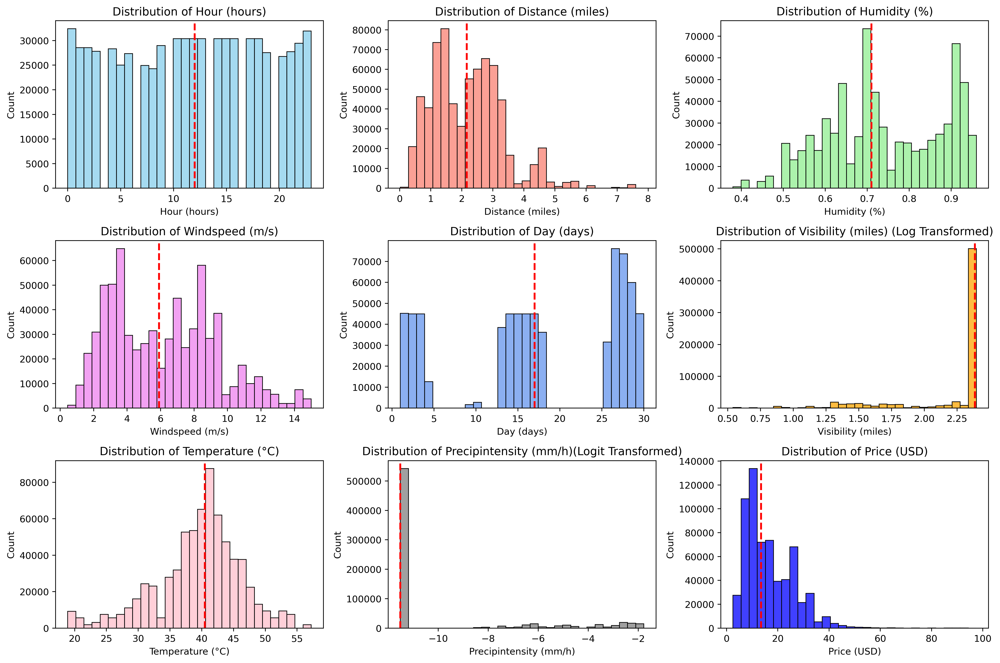

In [17]:
plt.rcParams['figure.dpi'] = 350  
fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(15, 10))  # Adjust the size and layout as needed
# List of columns and colors for the histograms
columns = ['hour', 'distance', 'humidity', 'windSpeed', 'day', 'visibility', 'temperature', 'precipIntensity', 'price']
units = ['hours', 'miles', '%', 'm/s', 'days', 'miles', '°C', 'mm/h', 'USD']
colors = ['skyblue', 'salmon', 'lightgreen', 'violet', 'cornflowerblue', 'orange', 'pink', 'grey', 'blue']
log_transform = ['visibility']  # Columns to log-transform
logit_transform = ['precipIntensity']
def logit_transform_function(x):
    # Adjusting 0 and 1 to avoid division by zero in log
    epsilon = 1e-5
    x = np.clip(x, epsilon, 1 - epsilon)
    return np.log(x / (1 - x))

for ax, col, color,unit in zip(axs.flat, columns, colors,units):
    data = df[col]
    # Apply log transformation if the column is in the log_transform list
    if col in log_transform:
        data = np.log1p(data)  # Using log1p for log transformation
        title_suffix = ' (Log Transformed)'
    elif col in logit_transform:
        data = logit_transform_function(data)
        title_suffix = '(Logit Transformed)'
    else:
        title_suffix = ''
    # Create histogram with seaborn
    sns.histplot(data, bins=30, ax=ax, color=color, kde=False)
    
    # Calculate the median and plot it
    median_val = data.median()
    ax.axvline(median_val, color='red', linestyle='--', linewidth=2)
    
    # Set title with unit
    ax.set_title(f'Distribution of {col.capitalize()} ({unit}){title_suffix}')
    
    # Set x-axis label with unit
    ax.set_xlabel(f'{col.capitalize()} ({unit})')
plt.savefig(f"./Figures/continuous_features_visualization.png")
plt.tight_layout()  # Adjust the spacing between plots
plt.show()


### Dealing with missing values

Let's also take a look at the only column 'price' that has missing values.

In [9]:
print(df[df['price'].isnull()])
print(df[(df['name'] == 'Taxi') & (df['price'].notnull())])
print(f"{df['price'].isnull().sum() * 100/df.shape[0]} % of the price values are missing")

                                          id     timestamp  hour  day  month  \
18      fa5fb705-03a0-4eb9-82d9-7fe80872f754  1.543674e+09    14    1     12   
31      eee70d94-6706-4b95-a8ce-0e34f0fa8f37  1.543795e+09    23    2     12   
40      7f47ff53-7cf2-4a6a-8049-83c90e042593  1.543524e+09    20   29     11   
60      43abdbe4-ab9e-4f39-afdc-31cfa375dc25  1.544732e+09    20   13     12   
69      80db1c49-9d51-4575-a4f4-1ec23b4d3e31  1.543583e+09    13   30     11   
...                                      ...           ...   ...  ...    ...   
693025  70ad9983-92dd-4cdf-af16-732e7e9ee9d0  1.544887e+09    15   15     12   
693047  84e05ef0-781a-4bd5-a593-bbbf659d4ba0  1.543456e+09     1   29     11   
693049  885ef635-299e-45cf-8052-c45a39e9822a  1.543456e+09     1   29     11   
693060  50a7b6be-ed2a-4a11-8d36-73bd977ad66a  1.543728e+09     5    2     12   
693068  64d451d0-639f-47a4-9b7c-6fd92fbd264f  1.543708e+09    23    1     12   

                   datetime          ti

### Removing Redundant Columns

 This step is to remove iredundant columns from the raw dataset. We see that there are a total of 57 columns which is too many to be used for EDA and ML later, thus it's best to remove as many as possible that are possibly insignificant. For this step, we divide it into Ride Columns and Weather Columns to be processed.

For ride columns. We already have hour, month and day extracted in the raw dataset which means that we don't need timestamp, datetime and timezone columns. Besides, we also don't need product_id as we already have name which represents the name of the product.

In [10]:
ride_cols = ["id", "timestamp", "timezone", "product_id"]

For weather columns, it becomes more tricky because some columns overlap and we have to choose which ones to keep and drop. For a approximate inspection, we compare 2 similar columns, which are short summary and icon column.

In [11]:
print(df['short_summary'].value_counts())
print(df['icon'].value_counts())
df.groupby(['short_summary'])['icon'].apply(lambda x: np.unique(x))

 Overcast             218895
 Mostly Cloudy        146210
 Partly Cloudy        127224
 Clear                 87126
 Light Rain            54912
 Rain                  23712
 Possible Drizzle      18636
 Foggy                  9060
 Drizzle                7296
Name: short_summary, dtype: int64
 cloudy                  218895
 partly-cloudy-night     158030
 partly-cloudy-day       115404
 rain                    104556
 clear-night              60294
 clear-day                26832
 fog                       9060
Name: icon, dtype: int64


short_summary
 Clear                                [ clear-day ,  clear-night ]
 Drizzle                                                  [ rain ]
 Foggy                                                     [ fog ]
 Light Rain                                               [ rain ]
 Mostly Cloudy        [ partly-cloudy-day ,  partly-cloudy-night ]
 Overcast                                               [ cloudy ]
 Partly Cloudy        [ partly-cloudy-day ,  partly-cloudy-night ]
 Possible Drizzle                                         [ rain ]
 Rain                                                     [ rain ]
Name: icon, dtype: object

We can see from the above side by side comparison, these two columns convey very similar information, then icon variable con be dropped so only short summary column will be used.

For rain, we'll take **precipIntensityMax** and eliminate the other 2 which are **precipIntensity(precipitation Intensity)** and **precipProbability**. For humidity, we'll take **humidity** and eliminate **dewPoint**. As for temperature, we'll take **temperature** only and eliminate 8 related temperature columns and also another 8 of those duplicate columns. For wind, we'll use **windSpeed** and **windGust** and eliminate **windGustTime** and **windBearing**. For visibility, we take **visibility** and eliminate **visibility.1.** **Ozone** and **UV** related columns are not significant so we remove them as well.

In [12]:
weather_cols = ["precipIntensity", "precipProbability", "windGustTime", "temperatureHigh", "temperatureHighTime", "temperatureLow", "temperatureLowTime", "apparentTemperatureHigh", "apparentTemperatureHighTime", "apparentTemperatureLow", "apparentTemperatureLowTime", "icon", "dewPoint", "windBearing", "uvIndex", "visibility.1", "ozone", "sunriseTime", "sunsetTime", "uvIndexTime", "temperatureMin", "temperatureMinTime", "temperatureMax", "temperatureMaxTime", "apparentTemperatureMin", "apparentTemperatureMinTime", "apparentTemperatureMax", "apparentTemperatureMaxTime", "apparentTemperature"]

In [13]:
# Drop the ride columns using axis=1
df = df.drop(ride_cols, axis=1)

# Drop the weather columns using axis=1
df = df.drop(weather_cols, axis=1)

Let's retake a look at the resulting dimension of the dataset.

In [14]:
print(df.shape)
print(df.info())

(693071, 24)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 24 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   hour                693071 non-null  int64  
 1   day                 693071 non-null  int64  
 2   month               693071 non-null  int64  
 3   datetime            693071 non-null  object 
 4   source              693071 non-null  object 
 5   destination         693071 non-null  object 
 6   cab_type            693071 non-null  object 
 7   name                693071 non-null  object 
 8   price               637976 non-null  float64
 9   distance            693071 non-null  float64
 10  surge_multiplier    693071 non-null  float64
 11  latitude            693071 non-null  float64
 12  longitude           693071 non-null  float64
 13  temperature         693071 non-null  float64
 14  short_summary       693071 non-null  object 
 15  long_summary        6

## Feature Engineering

### Deal with the datetime 

In [15]:
# Change the datetime column to datetime type
df['datetime'] = df['datetime'].apply(lambda x: datetime.datetime.strptime(x, "%Y-%m-%d %H:%M:%S"))
# Check the data type
df[['datetime']].dtypes
# Create a new column for the day of the week 
df['day_of_week'] = df['datetime'].apply(lambda x: calendar.day_name[x.weekday()])

In [16]:
df['moonPhase'].value_counts()

0.72    94544
0.68    63173
0.64    47931
0.79    45396
0.30    44928
0.27    44928
0.24    44928
0.33    44928
0.86    44928
0.82    44928
0.89    44772
0.21    44771
0.75    44581
0.37    26832
0.09     4447
0.93     3432
0.18     3120
0.60      504
Name: moonPhase, dtype: int64

In [17]:
df = df.drop(['datetime'], axis=1)

## Exploratory Data Analysis (EDA)

In EDA, few steps are important to be executed which are:

- Summary Statistics
- Boxplot
- Histogram
- Scatterplot
- Bar chart
- Correlation matrix

In [18]:
!pip install geopy

In [19]:
!pip install shapely

In [20]:
print(df[['latitude', 'longitude']].value_counts())
df[df['longitude'] == -71.1054]['source'].value_counts()

latitude  longitude
42.3647   -71.0542     98690
42.3661   -71.0631     95146
42.2148   -71.0330     88546
42.3503   -71.0810     61216
42.3519   -71.0643     61191
42.3505   -71.1054     54713
42.3519   -71.0551     50891
42.3644   -71.0661     42456
42.3429   -71.1003     42218
42.3588   -71.0707     42048
42.3398   -71.0892     29748
42.3559   -71.0550     26208
dtype: int64


Financial District         4859
Boston University          4771
Fenway                     4670
West End                   4659
South Station              4564
Northeastern University    4534
North End                  4510
Back Bay                   4509
Theatre District           4464
North Station              4431
Beacon Hill                4378
Haymarket Square           4364
Name: source, dtype: int64

From the above inspection, we find that the latitude/longitude in the dataset are not correspond to both source and destination location. Thus, a new processing procedure need to be applied on the location information

In [19]:
geodict = {'Back Bay': [42.350, -71.080],'North End':[42.365,-71.056],'Financial District':[42.355,-71.055],
           "West End":[42.365,-71.064],'Haymarket Square':[42.363,-71.058],'South Station':[42.352,-71.055],
           'Theatre District':[42.352,-71.064],'Beacon Hill':[42.356,-71.069],'Fenway':[42.346,-71.092],
           'North Station':[42.366,-71.062],'Boston University':[42.351,-71.105],'Northeastern University':[42.340,-71.090]}

In [20]:
df['destination_latitude'] = df['destination'].map(lambda x: geodict[x][0])
df['destination_longitude'] = df['destination'].map(lambda x: geodict[x][1])
df['source_latitude'] = df['source'].map(lambda x: geodict[x][0])
df['source_longitude'] = df['source'].map(lambda x: geodict[x][1])

In [23]:
import folium
from folium.plugins import HeatMap
source_of_ride = df[['source_latitude', 'source_longitude']].dropna().sample(500000)
destination_of_ride = df[['destination_latitude', 'destination_longitude']].dropna().sample(500000)

my_map=folium.Map(location = [42.320,-71.05], #Initiate map on Boston city
                  zoom_start = 11,
                  min_zoom = 11
)

HeatMap(data=source_of_ride, radius=10).add_to(my_map)
HeatMap(data=destination_of_ride, radius=20).add_to(my_map)

my_map

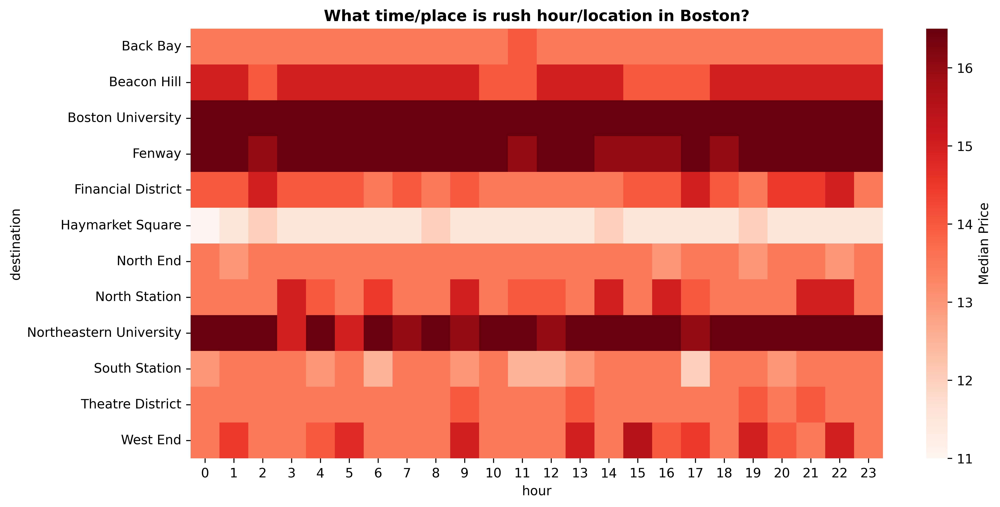

In [24]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Aggregate data. Here I'll take the mean of the 'price' column. 
# Replace 'price' with the correct column name if different.
heatmap_data = df.groupby(['destination', 'hour'])['price'].median().unstack()

# Plotting
plt.figure(figsize=(12, 6),dpi=600)
sns.heatmap(heatmap_data, cmap="Reds",cbar_kws={'label': 'Median Price'})
plt.title('What time/place is rush hour/location in Boston?', weight='bold')
plt.show()
plt.savefig(f"./Figures/time_place_median_price.png")


In [25]:

groupings = {
    'Shared': '1.Share',
    'UberPool': '1.Share',
    'Lyft': '2.Normal',
    'UberX': '2.Normal',
    'WAV': '2.Normal',
    'Lyft XL': '3.SUV',
    'UberXL': '3.SUV',
    'Lux': '4.Lux',
    'Lux Black': '4.Lux',
    'Black': '4.Lux',
    'Lux Black XL': '5.Lux SUV',
    'Black SUV': '5.Lux SUV'  # Hypothetical product for a group with 2/3 members
}


0               Shared
8               Shared
22              Shared
32              Shared
44              Shared
              ...     
693011    Lux Black XL
693017    Lux Black XL
693031    Lux Black XL
693035    Lux Black XL
693053    Lux Black XL
Name: group_name, Length: 637976, dtype: object


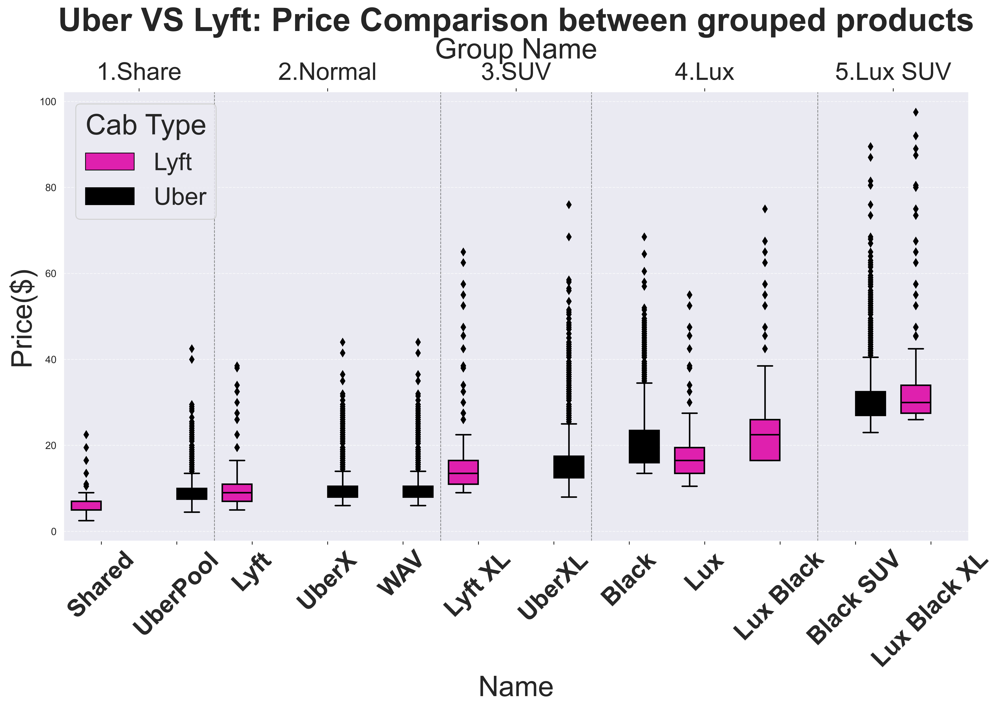

In [29]:
df_vis3 = df.copy()
df_vis3 = df_vis3[df_vis3['name']!="Taxi"]
df_vis3['group'] = df_vis3['name'].map(groupings)
sns.set_style("dark")
# Ensure groups and names are treated as ordered categories
group_order = ["1.Share", "2.Normal", "3.SUV", "4.Lux", "5.Lux SUV"] # Adjust as necessary
name_order = df_vis3.sort_values(by=['group', 'name'])['name'].unique().tolist()

df_vis3['group'] = pd.Categorical(df_vis3['group'], categories=group_order, ordered=True)
df_vis3['name'] = pd.Categorical(df_vis3['name'], categories=name_order, ordered=True)
df_vis3 = df_vis3.sort_values(by=['group', 'name'])
# Create a combined column for plotting
df_vis3['group_name'] = df_vis3['name'].astype(str)

# Create the boxplot with the new combined x-axis
plt.figure(figsize=(16, 8),dpi=600)
ax = sns.boxplot(x="group_name", y="price", hue="cab_type", data=df_vis3, palette=["#FF00BF", "black"])

# Add group name as secondary x-axis label
group_positions = []
group_centers = []
previous_group = None
# Add vertical dotted lines between groups
for i, product in enumerate(df_vis3['name'].unique()):
    current_group = df_vis3[df_vis3['name'] == product]['group'].iloc[0]
    if current_group != previous_group:
        group_positions.append(i)
        if len(group_positions) > 1:
            group_centers.append((group_positions[-2] + group_positions[-1]) / 2-0.5)
        previous_group = current_group
group_centers.append((group_positions[-1] + 12) / 2-0.5)
# Add vertical dotted lines between groups
for pos in group_positions[1:]:  # Skip the first group
    plt.axvline(x=pos-0.5, color='gray', linestyle='--', linewidth=0.7)

# Adjust x-tick labels to have product names, and a secondary x-axis for group names
ax = plt.gca()
ax.set_xticks(range(len(name_order)))
ax.set_xticklabels(name_order, rotation=45,size=24, weight='bold')
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
ax2.set_xticks(group_centers)
ax2.set_xticklabels(group_order,size=24)
ax2.set_xlabel('Group Name', size=28)

# Enhancing the plot
ax.set_title('Uber VS Lyft: Price Comparison between grouped products', weight='bold', size=32)
ax.set_ylabel('Price($)',size=28)
ax.set_xlabel('Name',size=28)
ax.legend(title='Cab Type', title_fontsize='28', fontsize='24')

# Displaying a grid
ax.grid(axis='y', linestyle='--', linewidth=0.7, alpha=0.7)
plt.savefig(f"./Figures/grouped_products_price_comparison.png")

plt.show()

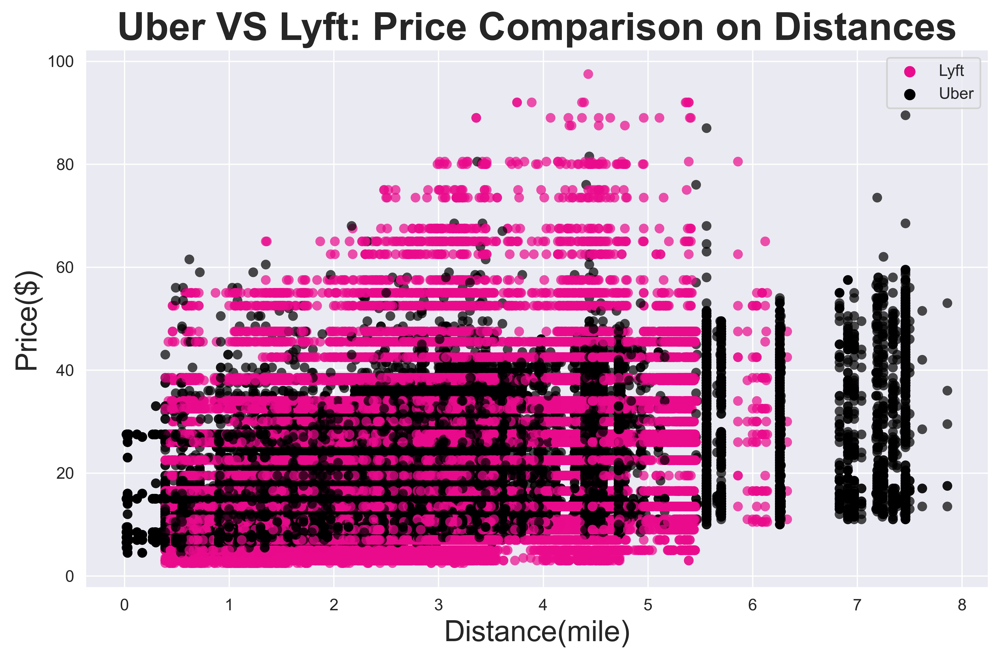

In [27]:
df_vis4 = df.copy()

plt.figure(figsize=(10, 6),dpi=600)
sns.set_style("darkgrid")

a4 = sns.scatterplot(x="distance", y="price", hue="cab_type", data=df_vis4, 
                     palette={"Lyft": "#ea0b8c", "Uber": "black"},edgecolor='None',alpha=0.7)

a4.set_title("Uber VS Lyft: Price Comparison on Distances", weight='bold', size=24)
a4.set_xlabel("Distance(mile)",size=18)
a4.set_ylabel("Price($)",size=18)
a4.legend(title="")
plt.savefig(f"./Figures/distance_price_comparison.png")
plt.show()

In [ ]:
from colour import Color
white = Color("white")
colors = list(white.range_to(Color("#ea0b8c"),9))
colors

[<Color white>,
 <Color #f0efed>,
 <Color #e0e5d6>,
 <Color #bcdebd>,
 <Color #9fdbc9>,
 <Color #7db7db>,
 <Color #6158df>,
 <Color #b82fe7>,
 <Color #ea0b8c>]

In [ ]:
!pip install colour

/var/folders/54/mdxj_jld4rq64y6469rvts2w0000gn/T/ipykernel_91909/3453472192.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_lyft['name'] = pd.Categorical(df_lyft['name'], categories=lyft_order, ordered=True)
/var/folders/54/mdxj_jld4rq64y6469rvts2w0000gn/T/ipykernel_91909/3453472192.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_uber['name'] = pd.Categorical(df_uber['name'], categories=uber_order, ordered=True)


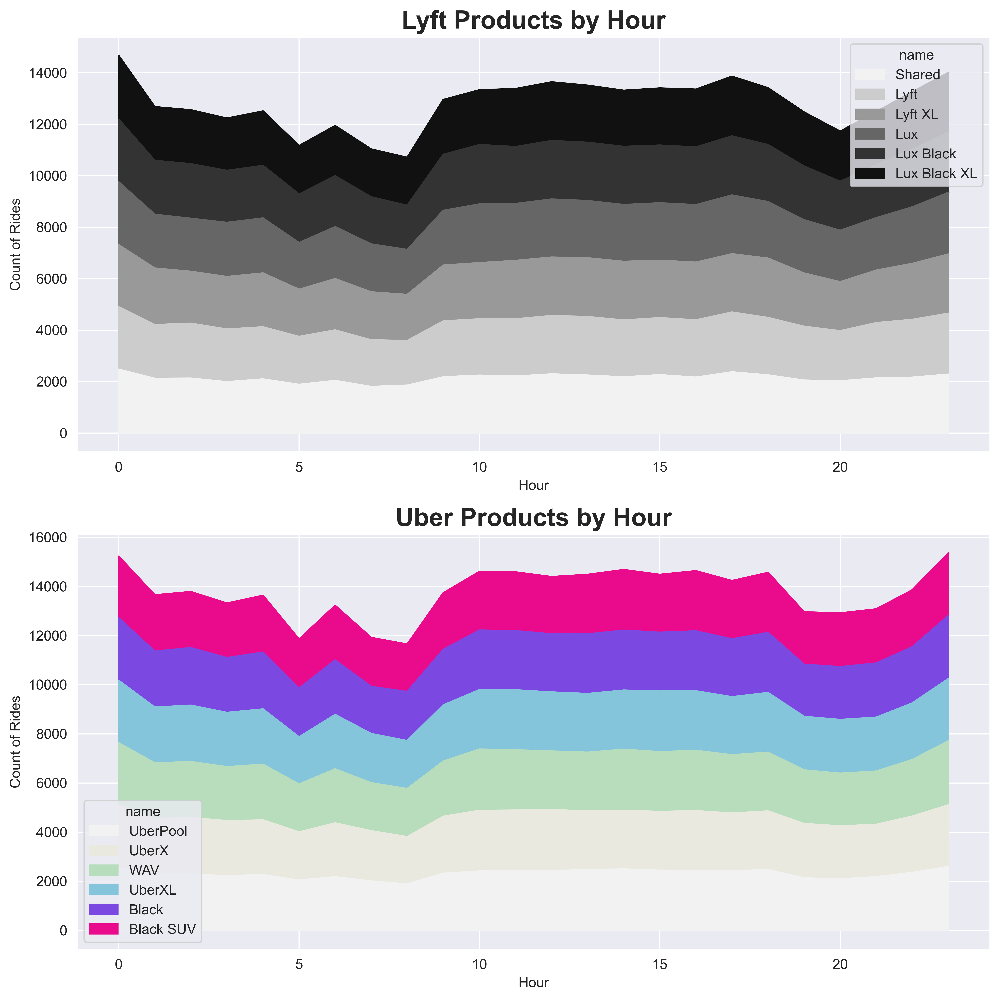

In [28]:
#Visualization 5: What time is the rush hour for Uber and Lyft?

# Filter dataframes
df_lyft = df[df['cab_type']=='Lyft']
df_uber = df[df['cab_type']=='Uber']

uber_order = ['UberPool', 'UberX', 'WAV', 'UberXL', 'Black', 'Black SUV']
lyft_order = ['Shared', 'Lyft', 'Lyft XL', 'Lux', 'Lux Black', 'Lux Black XL']

df_lyft['name'] = pd.Categorical(df_lyft['name'], categories=lyft_order, ordered=True)
df_uber['name'] = pd.Categorical(df_uber['name'], categories=uber_order, ordered=True)

# Group and pivot for Lyft
df_lyft_agg = df_lyft.groupby(['hour', 'name']).distance.count().reset_index()
df_lyft_pivot = df_lyft_agg.pivot(index='hour', columns='name', values='distance').fillna(0)

# Group and pivot for Uber
df_uber_agg = df_uber.groupby(['hour', 'name']).distance.count().reset_index()
df_uber_pivot = df_uber_agg.pivot(index='hour', columns='name', values='distance').fillna(0)
colors = ['#f2f2f2', '#ccc', '#999', '#666', '#333', '#111']
colorsu = ['#f2f2f2','#e9e9e0','#b7ddbd', '#84c5db','#7c48e2','#ea0b8c']
# Plot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 10),dpi=600)

# Plotting Lyft data
df_lyft_pivot.plot(kind='area', stacked=True, ax=ax1,color=colors)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Count of Rides')
ax1.set_title('Lyft Products by Hour',weight='bold', size=18)

# Plotting Uber data
df_uber_pivot.plot(kind='area', stacked=True, ax=ax2, color=colorsu)
ax2.set_xlabel('Hour')
ax2.set_ylabel('Count of Rides')
ax2.set_title('Uber Products by Hour',weight='bold', size=18)

plt.savefig(f"./Figures/ride_counts_by_hour.png")
plt.tight_layout()
plt.show()

In [ ]:
df['short_summary']

0          Mostly Cloudy 
1                   Rain 
2                  Clear 
3                  Clear 
4          Partly Cloudy 
               ...       
693065     Partly Cloudy 
693066     Partly Cloudy 
693067     Partly Cloudy 
693069     Partly Cloudy 
693070     Partly Cloudy 
Name: short_summary, Length: 637976, dtype: object

/var/folders/54/mdxj_jld4rq64y6469rvts2w0000gn/T/ipykernel_91909/4125634243.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_lyft['short_summary'] = df_lyft['short_summary'].astype('category')
/var/folders/54/mdxj_jld4rq64y6469rvts2w0000gn/T/ipykernel_91909/4125634243.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_lyft['short_summary'] = df_lyft['short_summary'].cat.set_categories(weather_order, ordered=True)
/var/folders/54/mdxj_jld4rq64y6469rvts2w0000gn/T/ipykernel_91909/4125634243.py:14: 

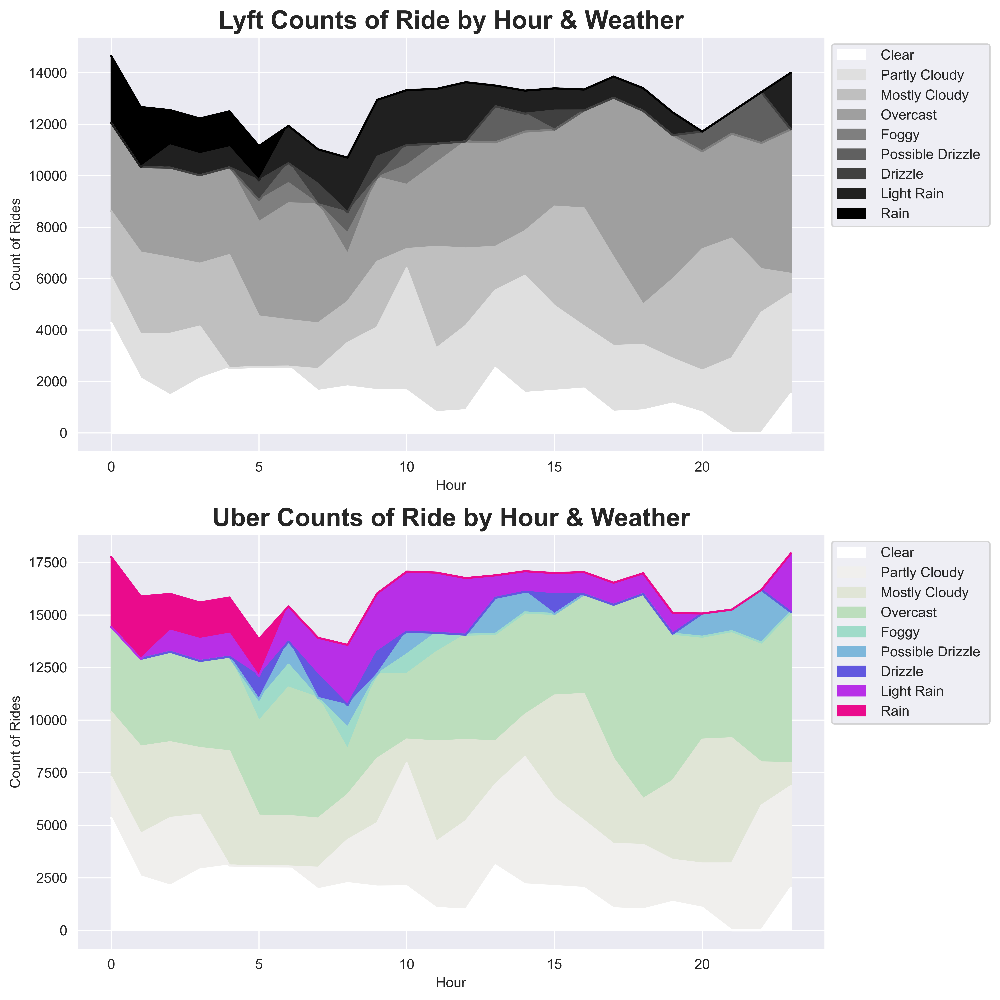

In [29]:
#Visualization 6: What time is the rush hour for Uber and Lyft?

# Filter dataframes
df_lyft = df[df['cab_type']=='Lyft']
df_uber = df[df['cab_type']=='Uber']


weather_order = [' Clear ', ' Partly Cloudy ', ' Mostly Cloudy ', ' Overcast ', ' Foggy ', ' Possible Drizzle ',' Drizzle ',' Light Rain ',' Rain ']


df_lyft['short_summary'] = df_lyft['short_summary'].astype('category')
df_lyft['short_summary'] = df_lyft['short_summary'].cat.set_categories(weather_order, ordered=True)

df_uber['short_summary'] = df_uber['short_summary'].astype(pd.CategoricalDtype(categories=weather_order, ordered=True))
# Group and pivot for Lyft
df_lyft_agg = df_lyft.groupby(['hour', 'short_summary']).distance.count().reset_index()
df_lyft_pivot = df_lyft_agg.pivot(index='hour', columns='short_summary', values='distance')

# Group and pivot for Uber
df_uber_agg = df_uber.groupby(['hour', 'short_summary']).distance.count().reset_index()
df_uber_pivot = df_uber_agg.pivot(index='hour', columns='short_summary', values='distance')
colors =  ['white','#dfdfdf','#bfbfbf','#9f9f9f','#7f7f7f','#606060','#404040','#202020','black']
colorsu =  ['white','#f0efed','#e0e5d6','#bcdebd', '#9fdbc9','#7db7db','#6158df','#b82fe7','#ea0b8c']
# Plot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 10),dpi=600)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
# Plotting Lyft data
df_lyft_pivot.plot(kind='area', stacked=True, ax=ax1,color=colors)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Count of Rides')
ax1.set_title('Lyft Counts of Ride by Hour & Weather',weight='bold', size=18)
ax1.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Plotting Uber data
df_uber_pivot.plot(kind='area', stacked=True, ax=ax2, color=colorsu)
ax2.set_xlabel('Hour')
ax2.set_ylabel('Count of Rides')
ax2.set_title('Uber Counts of Ride by Hour & Weather',weight='bold', size=18)
ax2.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.savefig(f"./Figures/ride_counts_by_hour_weather.png")
plt.tight_layout()
plt.show()

### Using Kfold method to split the dataset ###

In [ ]:
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split 

random_state =42
y = df['price']
X = df.loc[:, df.columns != 'price']
# first split to separate out the test set
X_other, X_test, y_other, y_test = train_test_split(X,y,test_size = 0.2,random_state=random_state)
print(X_other.shape,y_other.shape)
print('test set:',X_test.shape,y_test.shape)

# do KFold split on other
kf = KFold(n_splits=3,shuffle=True,random_state=random_state)
for train_index, val_index in kf.split(X_other,y_other):
    X_train = X_other.iloc[train_index]
    y_train = y_other.iloc[train_index]
    X_val = X_other.iloc[val_index]
    y_val = y_other.iloc[val_index]
    print('   training set:',X_train.shape, y_train.shape) 
    print('   validation set:',X_val.shape, y_val.shape) 

(510380, 24) (510380,)
test set: (127596, 24) (127596,)
   training set: (340253, 24) (340253,)
   validation set: (170127, 24) (170127,)
   training set: (340253, 24) (340253,)
   validation set: (170127, 24) (170127,)
   training set: (340254, 24) (340254,)
   validation set: (170126, 24) (170126,)


### Collect which encoder to use on each feature ###

In [30]:
df.describe()

,hour,day,month,price,distance,surge_multiplier,latitude,longitude,temperature,humidity,windSpeed,windGust,visibility,pressure,cloudCover,moonPhase,precipIntensityMax,destination_latitude,destination_longitude,source_latitude,source_longitude
count,693071.000000,693071.000000,693071.000000,637976.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000,693071.000000
mean,11.619137,17.794365,11.586684,16.545125,2.189430,1.013870,42.338172,-71.066151,39.584388,0.741119,6.186253,8.469860,8.467970,1010.094766,0.686502,0.579066,0.037374,42.355070,-71.070819,42.355069,-71.070820
std,6.948114,9.982286,0.492429,9.324359,1.138937,0.091641,0.047840,0.020302,6.726084,0.138595,3.148223,5.289179,2.602888,13.472899,0.358534,0.244705,0.055214,0.007902,0.016155,0.007902,0.016155
min,0.000000,1.000000,11.000000,2.500000,0.020000,1.000000,42.214800,-71.105400,18.910000,0.380000,0.450000,0.800000,0.717000,988.090000,0.000000,0.090000,0.000000,42.340000,-71.105000,42.340000,-71.105000
25%,6.000000,13.000000,11.000000,9.000000,1.280000,1.000000,42.350300,-71.081000,36.450000,0.640000,3.410000,4.060000,8.432000,999.820000,0.370000,0.300000,0.000000,42.350000,-71.090000,42.350000,-71.090000
50%,12.000000,17.000000,12.000000,13.500000,2.160000,1.000000,42.351900,-71.063100,40.490000,0.710000,5.910000,7.550000,9.880000,1009.250000,0.820000,0.680000,0.000400,42.352000,-71.064000,42.352000,-71.064000
75%,18.000000,28.000000,12.000000,22.500000,2.920000,1.000000,42.364700,-71.054200,43.580000,0.880000,8.410000,11.740000,9.996000,1021.860000,1.000000,0.790000,0.091600,42.363000,-71.056000,42.363000,-71.056000
max,23.000000,30.000000,12.000000,97.500000,7.860000,3.000000,42.366100,-71.033000,57.220000,0.960000,15.000000,27.250000,10.000000,1035.550000,1.000000,0.930000,0.145900,42.366000,-71.055000,42.366000,-71.055000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 637976 entries, 0 to 693070
Data columns (total 21 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   hour                637976 non-null  int64  
 1   day                 637976 non-null  int64  
 2   month               637976 non-null  int64  
 3   source              637976 non-null  object 
 4   destination         637976 non-null  object 
 5   cab_type            637976 non-null  object 
 6   name                637976 non-null  object 
 7   price               637976 non-null  float64
 8   distance            637976 non-null  float64
 9   surge_multiplier    637976 non-null  float64
 10  temperature         637976 non-null  float64
 11  short_summary       637976 non-null  object 
 12  humidity            637976 non-null  float64
 13  windSpeed           637976 non-null  float64
 14  windGust            637976 non-null  float64
 15  visibility          637976 non-nul

In [32]:
df = df.drop(['long_summary','latitude','longitude'], axis=1)

In [34]:
df = df.drop(['source_latitude','source_longitude','destination_latitude','destination_longitude'], axis=1)

In [ ]:
df.to_csv('dataset/rideshare_kaggle_cleaned.csv', index=False)

In [ ]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler

cat_ftrs = ['hour','day','month','day_of_week','cab_type','destination','source','short_summary','name']
num_ftrs = ['surge_multiplier','distance','temperature','humidity','windSpeed','windGust','visibility','pressure','cloudCover','moonPhase','precipIntensityMax']

categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(sparse=False,handle_unknown='ignore'))])

# standard scaler
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())])

# collect the transformers
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, num_ftrs),
        ('cat', categorical_transformer, cat_ftrs)])


In [ ]:
# fit_transform the training set
X_prep = preprocessor.fit_transform(X_train)
# the feature names after fit
feature_names = preprocessor.get_feature_names_out()

# you can convert the numpy array back to a data frame with the feature names if you want
df_train = pd.DataFrame(data=X_prep,columns=feature_names)
print(df_train.shape)

# transform the CV
df_val = preprocessor.transform(X_val)
df_val = pd.DataFrame(data=df_val,columns = feature_names)
print(df_val.shape)

# transform the test
df_test = preprocessor.transform(X_test)
df_test = pd.DataFrame(data=df_test,columns = feature_names)
print(df_test.shape)
print(feature_names)

(340254, 108)
(170126, 108)
(127596, 108)
['num__surge_multiplier' 'num__distance' 'num__temperature'
 'num__humidity' 'num__windSpeed' 'num__windGust' 'num__visibility'
 'num__pressure' 'num__cloudCover' 'num__moonPhase'
 'num__precipIntensityMax' 'cat__hour_0' 'cat__hour_1' 'cat__hour_2'
 'cat__hour_3' 'cat__hour_4' 'cat__hour_5' 'cat__hour_6' 'cat__hour_7'
 'cat__hour_8' 'cat__hour_9' 'cat__hour_10' 'cat__hour_11' 'cat__hour_12'
 'cat__hour_13' 'cat__hour_14' 'cat__hour_15' 'cat__hour_16'
 'cat__hour_17' 'cat__hour_18' 'cat__hour_19' 'cat__hour_20'
 'cat__hour_21' 'cat__hour_22' 'cat__hour_23' 'cat__day_1' 'cat__day_2'
 'cat__day_3' 'cat__day_4' 'cat__day_9' 'cat__day_10' 'cat__day_13'
 'cat__day_14' 'cat__day_15' 'cat__day_16' 'cat__day_17' 'cat__day_18'
 'cat__day_26' 'cat__day_27' 'cat__day_28' 'cat__day_29' 'cat__day_30'
 'cat__month_11' 'cat__month_12' 'cat__day_of_week_Friday'
 'cat__day_of_week_Monday' 'cat__day_of_week_Saturday'
 'cat__day_of_week_Sunday' 'cat__day_of_week_T